In [1]:
import torch
from torchvision import transforms
from torch.utils.data.dataset import Dataset

In [2]:
import cv2
import os
import numpy as np

from random import randint
from tqdm import tqdm

ORIGINAL_IMAGES = './ORIGINALS'
RESULTING_IMAGES = './PROCESSED'

X_IMAGES_PATH = os.path.join(RESULTING_IMAGES, 'X_images')
Y_IMAGES_PATH = os.path.join(RESULTING_IMAGES, 'y_images')

x_images = []
y_images = []


def get_random_square():
    size = randint(2, 100)
    x = randint(0, 300 - size)
    y = randint(0, 300 - size)
    
    return (size, (x, y))


def get_transparent_image():
    return np.zeros((300, 300, 3))


def draw_square(img, square):
    start_point = square[1]
    size = square[0]
    end_point = (start_point[0] + size, start_point[1] + size)
    
    return cv2.rectangle(img, start_point, end_point, (0, 0, 255), -1)


def flip_draw_save(img, file_name, to):
    modif_img = cv2.flip( img, to )
    
    square = get_random_square()
    X_image = draw_square(modif_img, square)
    y_image = draw_square(get_transparent_image(), square)
    
    if to == 1:
        to_str = 'h_'
    elif to == 0:
        to_str = 'v_'
    else:
        to_str = 'hv_'
        
    
    cv2.imwrite(os.path.join(X_IMAGES_PATH, to_str + file_name), X_image)
    cv2.imwrite(os.path.join(Y_IMAGES_PATH, to_str + file_name), y_image)
    

def rotate_draw_save(img, file_name, degrees):
    (h, w) = img.shape[:2                ]
    # calculate the center of the image
    center = (w / 2, h / 2)
 
    scale = 1.0
 
    # Perform the counter clockwise rotation holding at the center
    M = cv2.getRotationMatrix2D(center, degrees, scale)
    modif_img = cv2.warpAffine(img, M, (h, w))
    
    square = get_random_square()
    X_image = draw_square(modif_img, square)
    y_image = draw_square(get_transparent_image(), square)
    
    cv2.imwrite(os.path.join(X_IMAGES_PATH, str(degrees) + '_' + file_name), X_image)
    cv2.imwrite(os.path.join(Y_IMAGES_PATH, str(degrees) + '_' + file_name), y_image)
    
    
for file_name in tqdm(os.listdir(ORIGINAL_IMAGES)):
    o_image = cv2.imread(os.path.join(ORIGINAL_IMAGES, file_name), 3)
    r_image = cv2.resize(o_image, (300, 300))
    
    for_horizontal = r_image.copy()
    for_vertical = r_image.copy()
    for_both = r_image.copy()
    for_90 = r_image.copy()
    for_180 = r_image.copy()
    for_270 = r_image.copy()
    
    square = get_random_square()
    X_image = draw_square(r_image, square)
    y_image = draw_square(get_transparent_image(), square)
    
    flip_draw_save(for_horizontal, file_name, 1)
    flip_draw_save(for_vertical, file_name, 0)
    flip_draw_save(for_both, file_name, -1)
    
    rotate_draw_save(for_horizontal, file_name, 90)
    rotate_draw_save(for_vertical, file_name, 180)
    rotate_draw_save(for_both, file_name, 270)
    
    cv2.imwrite(os.path.join(X_IMAGES_PATH, file_name), X_image)
    cv2.imwrite(os.path.join(Y_IMAGES_PATH, file_name), y_image)
    
print('Done.')
    
    

100%|██████████| 141/141 [00:17<00:00,  7.95it/s]

Done.


In [3]:
class CustomDataSet(Dataset):
    
    def __init__(self, images_path, transforms=None):
        self.X_images = os.path.join(images_path, 'X_images')
        self.y_images = os.path.join(images_path, 'y_images')
        
        self.X_images = sorted(os.listdir(self.X_images))
        self.y_images = sorted(os.listdir(self.y_images))
        
        self.transforms = transforms
    
    def __getitem__(self, index):
        X_image = cv2.imread(os.path.join(X_IMAGES_PATH, self.X_images[index]), 3)
        y_image = cv2.imread(os.path.join(Y_IMAGES_PATH, self.y_images[index]), 3)
        
        return transforms.ToTensor()(X_image), transforms.ToTensor()(y_image)
        
    
    def __len__(self):
        return len(self.X_images)
    

custom_dataset = CustomDataSet(RESULTING_IMAGES)
data_loader = torch.utils.data.DataLoader(dataset=custom_dataset, batch_size=3, shuffle=True)

train_size = int(0.9 * len(custom_dataset))
test_size = len(custom_dataset) - train_size
train_dataset, test_dataset = torch.utils.data.random_split(custom_dataset, [train_size, test_size])


In [4]:
import matplotlib.pyplot as plt

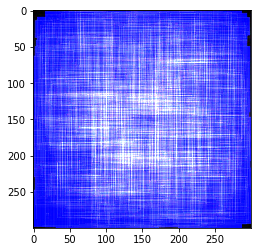

In [5]:
images = []

for image in os.listdir(Y_IMAGES_PATH):
    images.append(cv2.imread(os.path.join(Y_IMAGES_PATH, image), 3))
    
img = images[0]
for i in images[1:]:
    img = cv2.addWeighted(img, 1, i, 1, 0)

plt.imshow(img)

In [6]:
import torch.nn as nn
import torch.nn.functional as F

class ConvNet(nn.Module):
    
    def __init__(self):
        super().__init__()
        
        self.conv1 = nn.Sequential(
            nn.Conv2d(3, 6, 3, 1, 1), nn.BatchNorm2d(6), nn.ReLU()
        )
        self.conv2 = nn.Sequential(
            nn.Conv2d(6, 16, 3, 1, 1), nn.BatchNorm2d(16), nn.ReLU()
        )
        self.conv3 = nn.Sequential(
            nn.Conv2d(16, 32, 3, 1, 1), nn.BatchNorm2d(32), nn.ReLU()
        )
        
        self.conv4 = nn.Sequential(
            nn.Conv2d(32, 32, 3, 1, 1), nn.BatchNorm2d(32), nn.ReLU()
        )
        
        
        self.conv5 = nn.Sequential(
            nn.Conv2d(32, 16, 3, 1, 1), nn.BatchNorm2d(16), nn.ReLU()
        )
        self.conv6 = nn.Sequential(
            nn.Conv2d(16, 6, 3, 1, 1), nn.BatchNorm2d(6), nn.ReLU()
        )
        
        self.conv7 = nn.Conv2d(6, 3, 3, 1, 1)
        
        self.t_conv1 = nn.ConvTranspose2d(32, 32, 6, 2, 2, 1)
        self.t_conv2 = nn.ConvTranspose2d(16, 16, 5, 2, 2, 1)
        self.t_conv3 = nn.ConvTranspose2d(6, 6, 5, 2, 2, 1)
    
    def forward(self, X):
        X = F.max_pool2d(self.conv1(X), (2,2))
        X = F.max_pool2d(self.conv2(X), (2,2))
        X = F.max_pool2d(self.conv3(X), (2,2))
        
        X = self.conv4(X)
        X = self.t_conv1(X)
        
        X = self.conv5(X)
        X = self.t_conv2(X)
        
        X = self.conv6(X)
        X = self.t_conv3(X)
        
        X = self.conv7(X)
        
        return X
    

conv_net = ConvNet()

In [ ]:
import torch.optim as optim

optimizer = optim.Adam(conv_net.parameters(), lr=0.001)

EPOCHS = 150

for epoch in range(EPOCHS):
    for data in tqdm(train_dataset):
        X_image, y_image = data
        
        optimizer.zero_grad()
        
        output = conv_net(X_image.unsqueeze(0))
        
        loss = nn.MSELoss()(output.squeeze(), y_image)
        loss.backward()
        
        optimizer.step()
        
    print('EPOCH:', epoch, '->', loss)
    

  0%|          | 1/888 [00:00<02:29,  5.92it/s]

EPOCH: 0 -> tensor(0.0016, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:40,  5.53it/s]

EPOCH: 1 -> tensor(0.0004, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:30,  5.90it/s]

EPOCH: 2 -> tensor(0.0006, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:39,  5.56it/s]

EPOCH: 3 -> tensor(0.0002, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:48,  5.25it/s]

EPOCH: 4 -> tensor(0.0002, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:30,  5.87it/s]

EPOCH: 5 -> tensor(0.0001, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:30,  5.91it/s]

EPOCH: 6 -> tensor(0.0002, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:48,  5.25it/s]

EPOCH: 7 -> tensor(0.0003, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:41,  5.49it/s]

EPOCH: 8 -> tensor(0.0001, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:38,  5.60it/s]

EPOCH: 9 -> tensor(0.0002, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:26,  6.05it/s]

EPOCH: 10 -> tensor(7.4935e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:28,  5.97it/s]

EPOCH: 11 -> tensor(8.0583e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:27,  6.01it/s]

EPOCH: 12 -> tensor(7.4039e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:36,  5.67it/s]

EPOCH: 13 -> tensor(9.7673e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:38,  5.59it/s]

EPOCH: 14 -> tensor(7.0972e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:31,  5.87it/s]

EPOCH: 15 -> tensor(4.9318e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:25,  6.09it/s]

EPOCH: 16 -> tensor(5.3770e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:40,  5.52it/s]

EPOCH: 17 -> tensor(6.5629e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:34,  5.75it/s]

EPOCH: 18 -> tensor(4.9102e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:40,  5.53it/s]

EPOCH: 19 -> tensor(3.8032e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:37,  5.62it/s]

EPOCH: 20 -> tensor(3.5413e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:23,  6.18it/s]

EPOCH: 21 -> tensor(3.7311e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:25,  6.08it/s]

EPOCH: 22 -> tensor(3.8528e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:23,  6.18it/s]

EPOCH: 23 -> tensor(3.5722e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:23,  6.19it/s]

EPOCH: 24 -> tensor(6.1410e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:24,  6.13it/s]

EPOCH: 25 -> tensor(4.4931e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:30,  5.89it/s]

EPOCH: 26 -> tensor(3.7786e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:26,  6.04it/s]

EPOCH: 27 -> tensor(3.2902e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:32,  5.80it/s]

EPOCH: 28 -> tensor(3.2129e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:31,  5.87it/s]

EPOCH: 29 -> tensor(3.3716e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:30,  5.90it/s]

EPOCH: 30 -> tensor(3.0832e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:34,  5.75it/s]

EPOCH: 31 -> tensor(3.1436e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:29,  5.93it/s]

EPOCH: 32 -> tensor(2.7846e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:38,  5.60it/s]

EPOCH: 33 -> tensor(2.9954e-05, grad_fn=<MseLossBackward>)


  0%|          | 0/888 [00:00<?, ?it/s]

EPOCH: 34 -> tensor(2.5135e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:36,  5.67it/s]

EPOCH: 35 -> tensor(2.5117e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:32,  5.80it/s]

EPOCH: 36 -> tensor(2.3963e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:35,  5.72it/s]

EPOCH: 37 -> tensor(4.0562e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:42,  5.46it/s]

EPOCH: 38 -> tensor(2.8047e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:38,  5.59it/s]

EPOCH: 39 -> tensor(2.4347e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:31,  5.85it/s]

EPOCH: 40 -> tensor(1.9705e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:53,  5.11it/s]

EPOCH: 41 -> tensor(1.8036e-05, grad_fn=<MseLossBackward>)


  0%|          | 1/888 [00:00<02:39,  5.57it/s]

EPOCH: 42 -> tensor(1.9250e-05, grad_fn=<MseLossBackward>)


  9%|▉         | 79/888 [00:13<02:19,  5.78it/s]

In [53]:
images = []
outputs = []
expected = []

with torch.no_grad():
    for X_image, y_image in tqdm(test_dataset):
        output = conv_net(X_image.unsqueeze(0))
        
        images.append(X_image)
        outputs.append(output.squeeze())
        expected.append(y_image)
    
        #print('>>> NET RESULT')
        #plt.imshow(output.squeeze()[2].view(100, 100))
        #plt.show()
        
        #print('>>> EXPECTED RESULT')
        #plt.imshow(y_image[2].view(100, 100))
        #plt.show()

100%|██████████| 99/99 [00:05<00:00, 19.02it/s]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


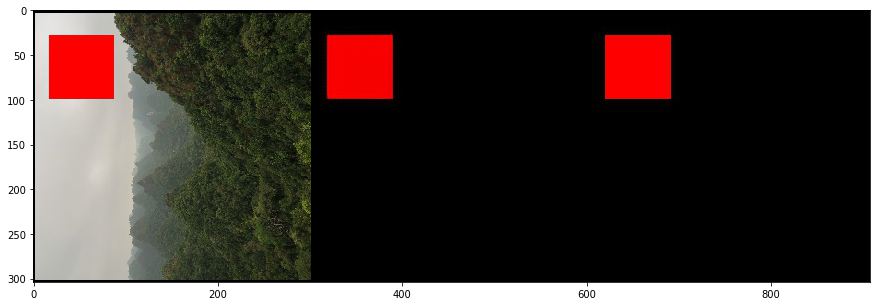

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


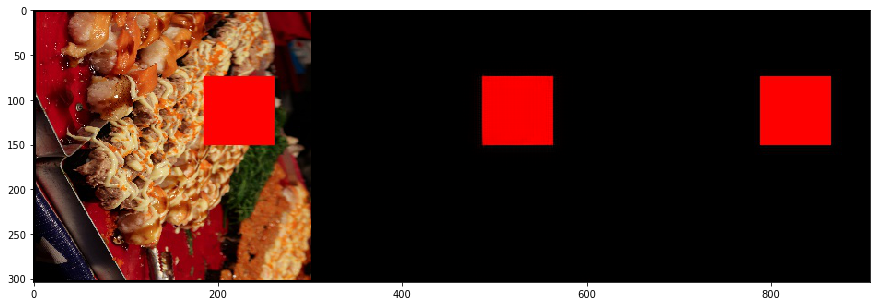

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


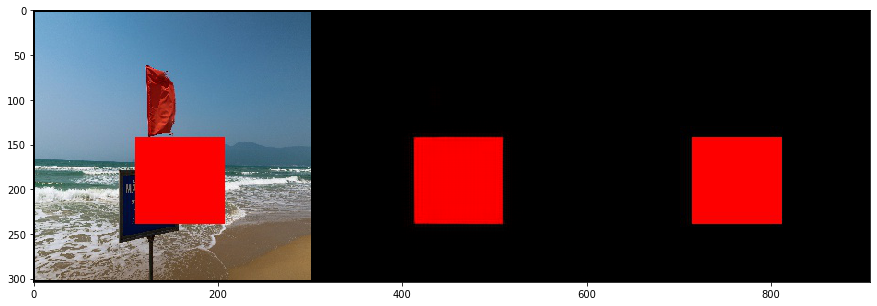

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


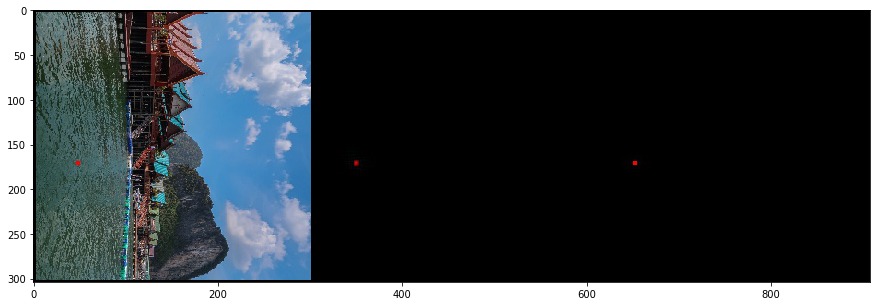

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


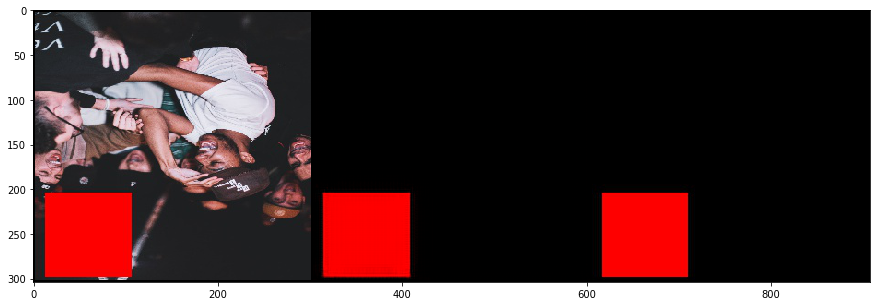

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


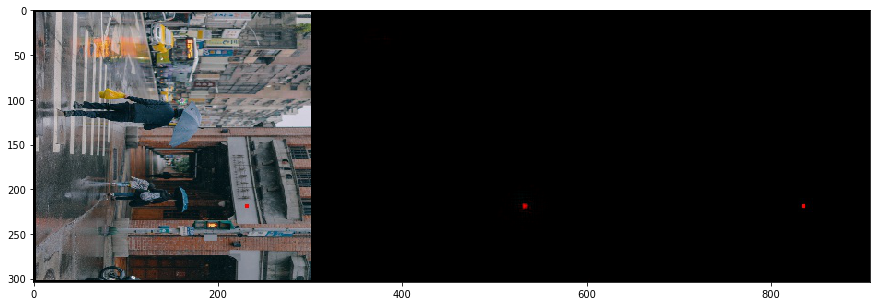

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


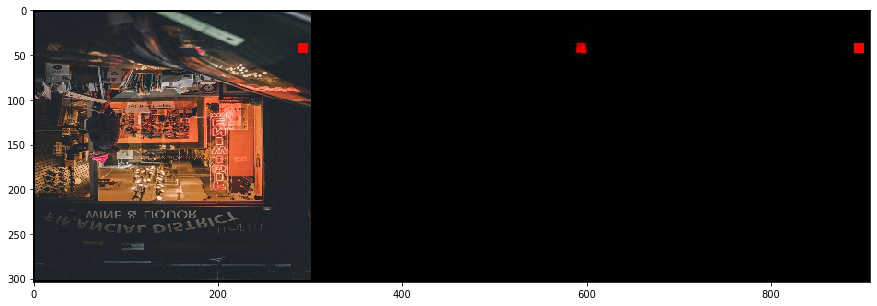

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


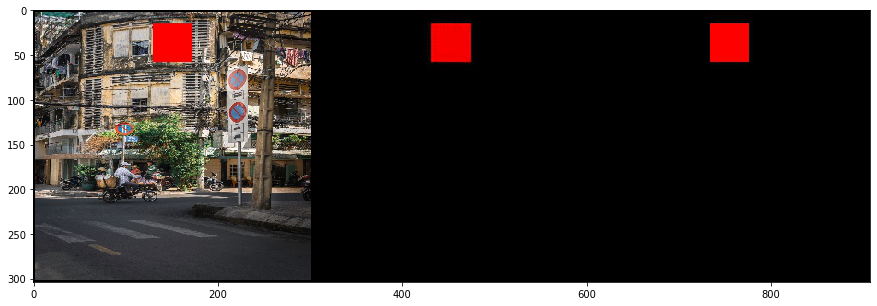

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


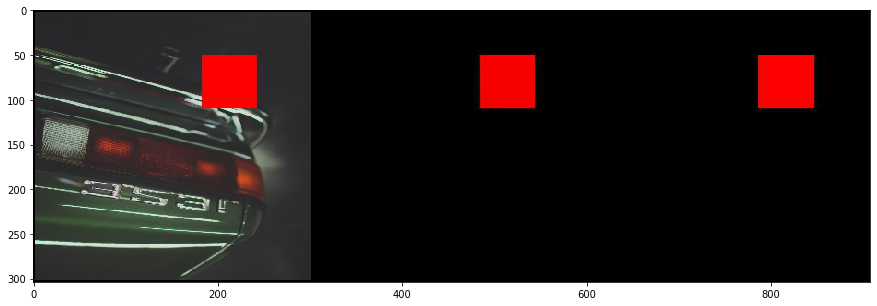

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


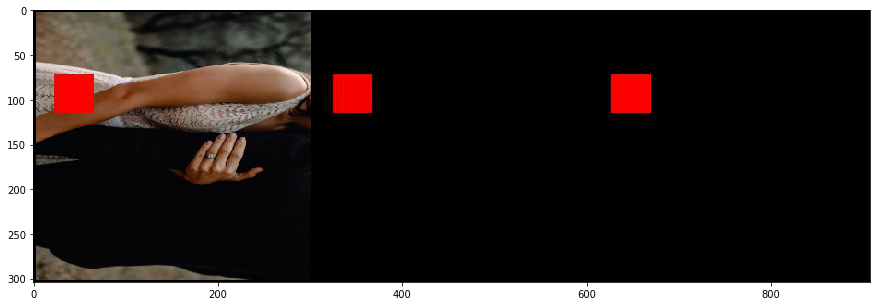

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


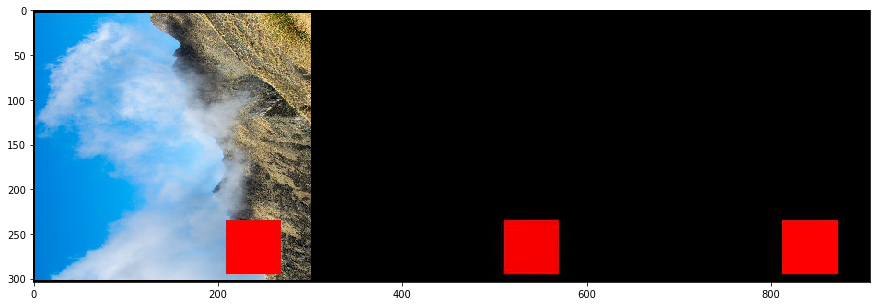

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


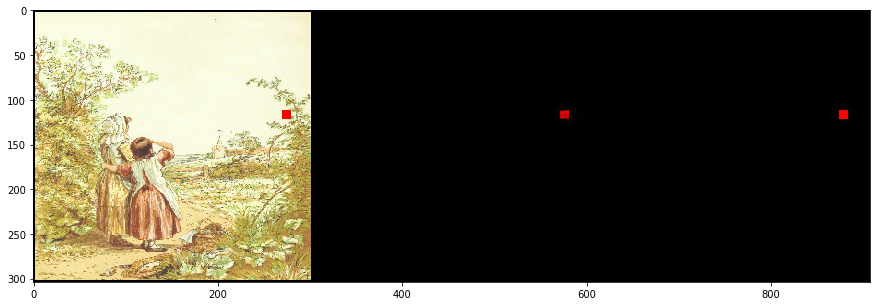

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


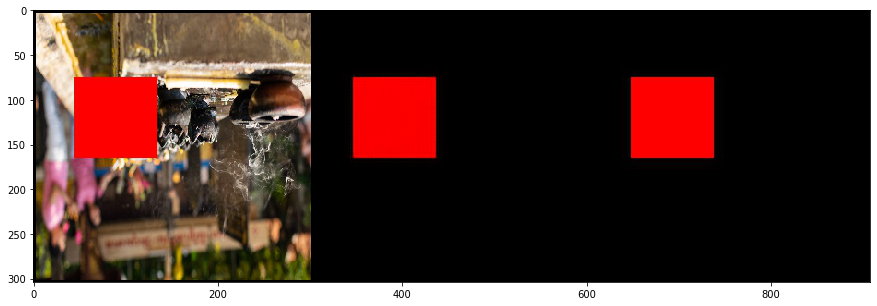

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


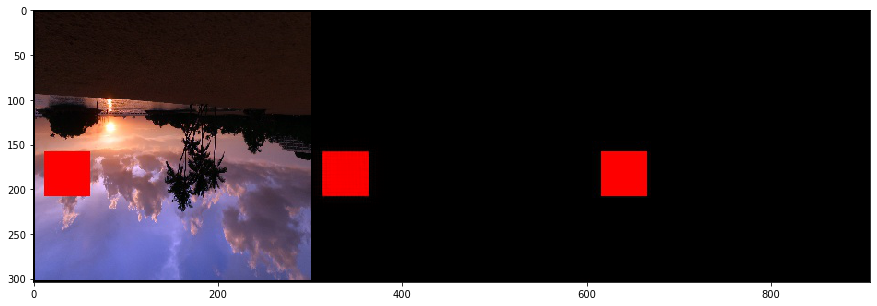

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


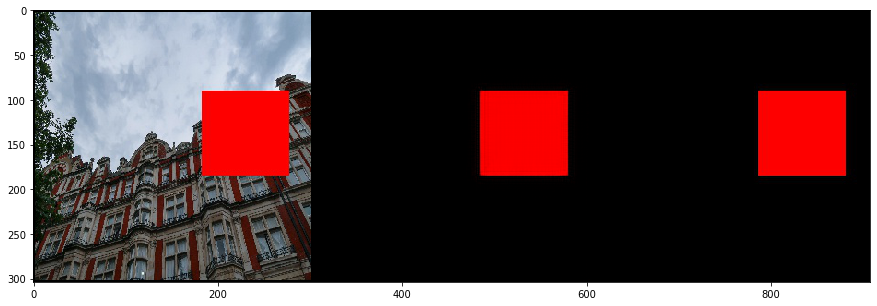

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


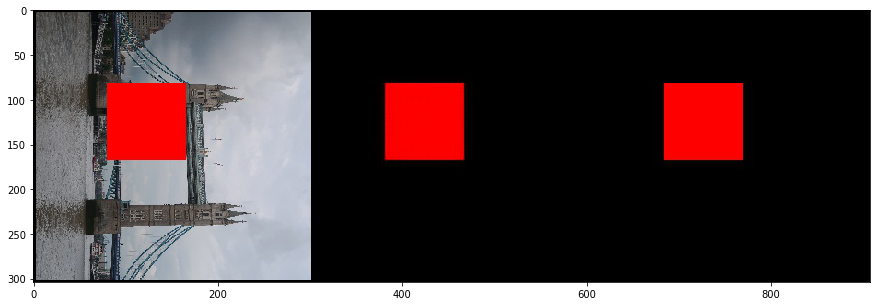

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


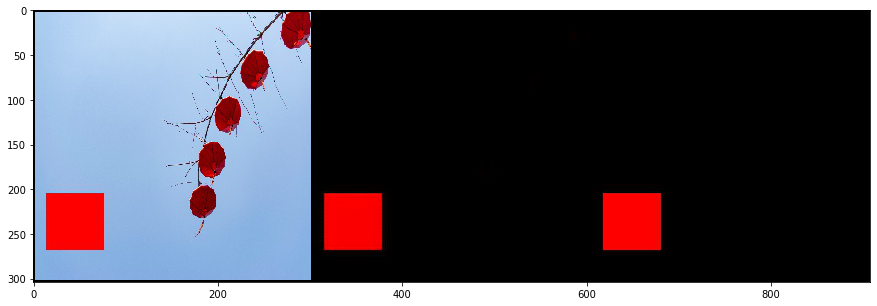

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


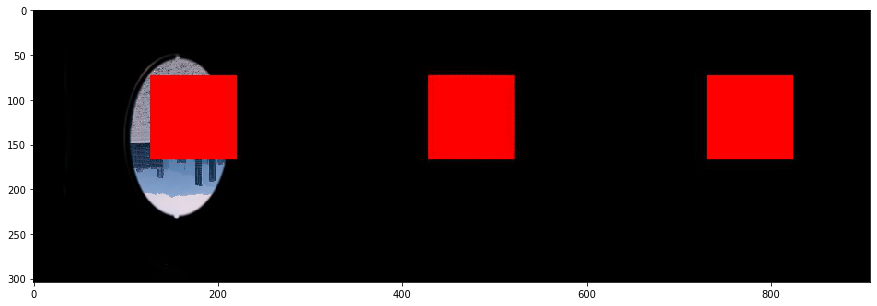

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


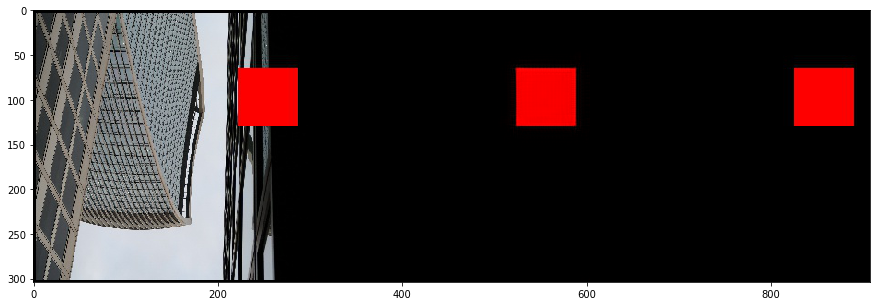

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


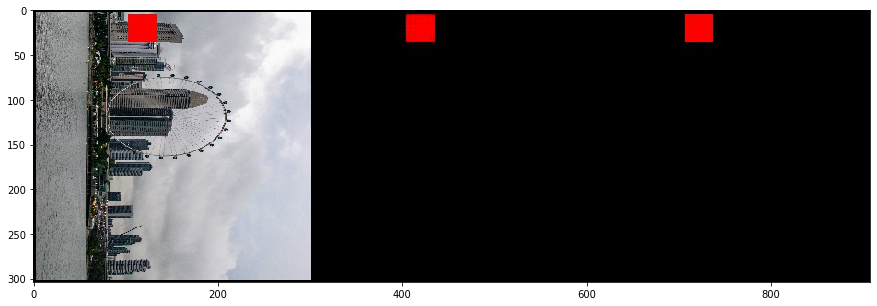

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


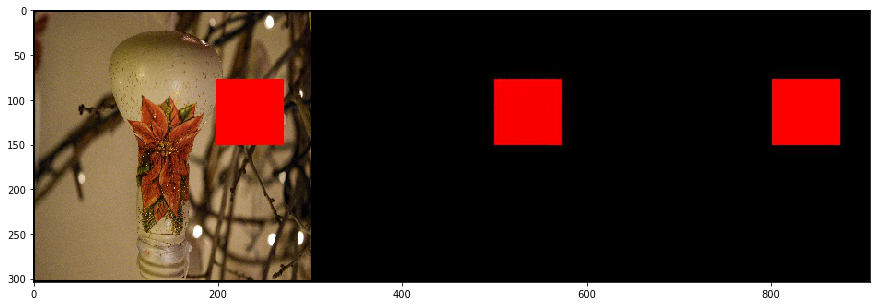

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


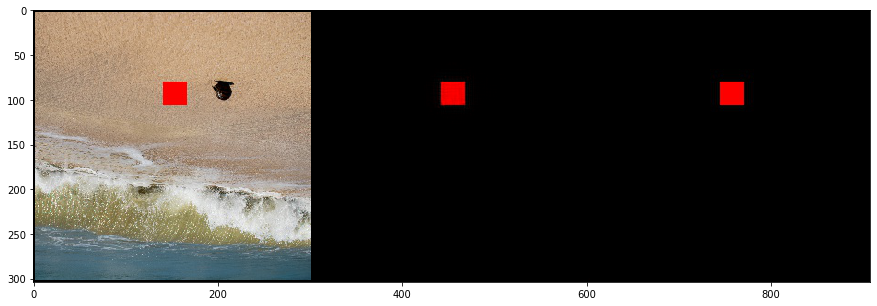

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


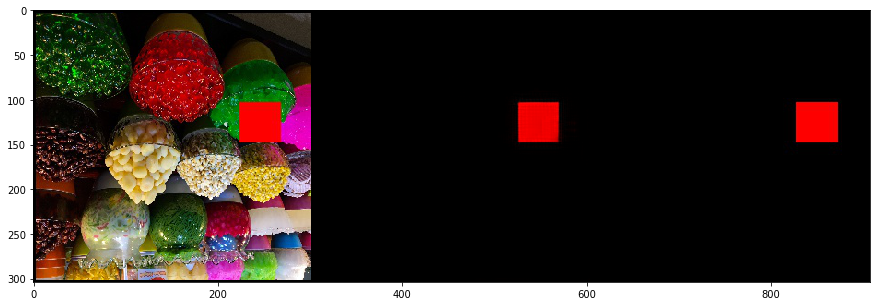

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


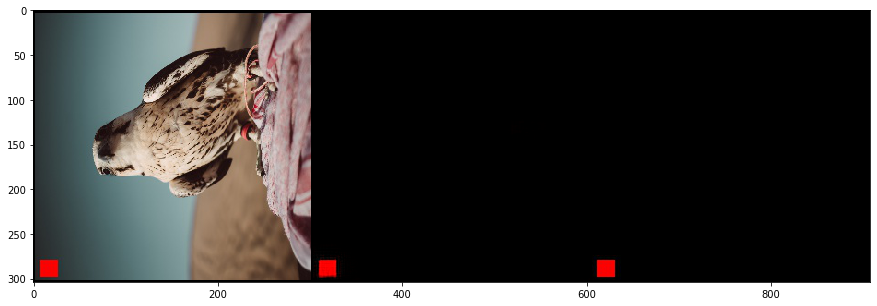

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


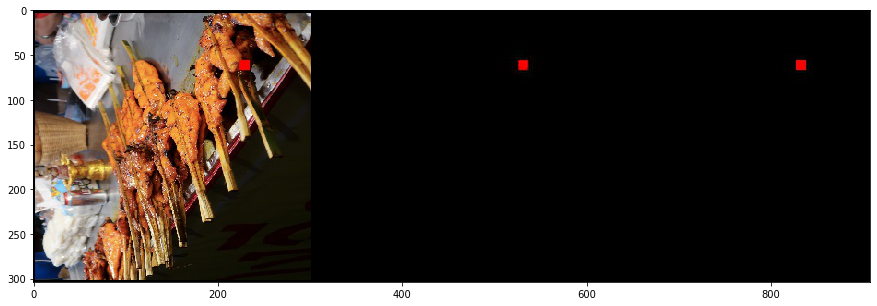

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


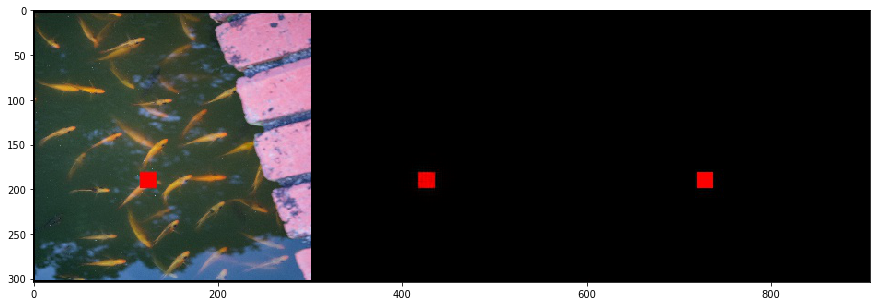

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


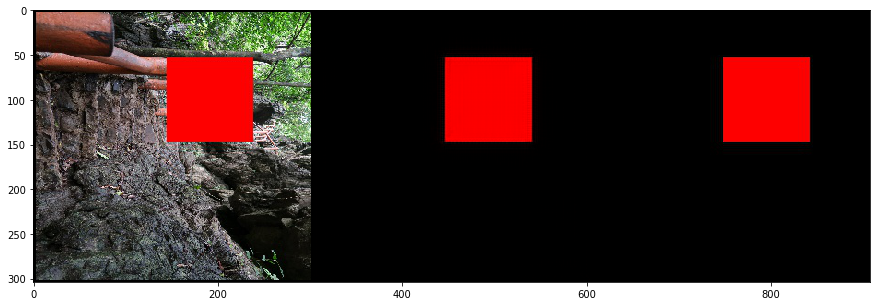

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


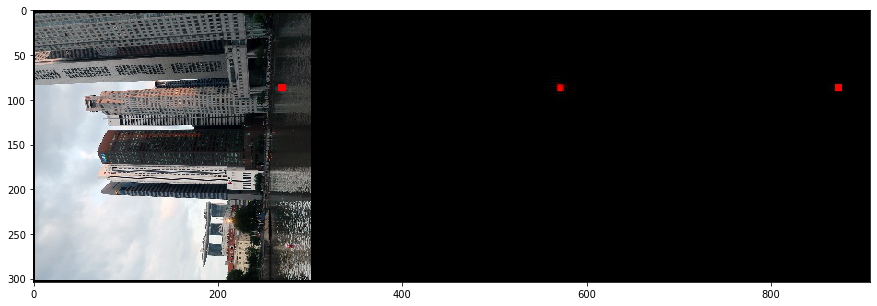

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


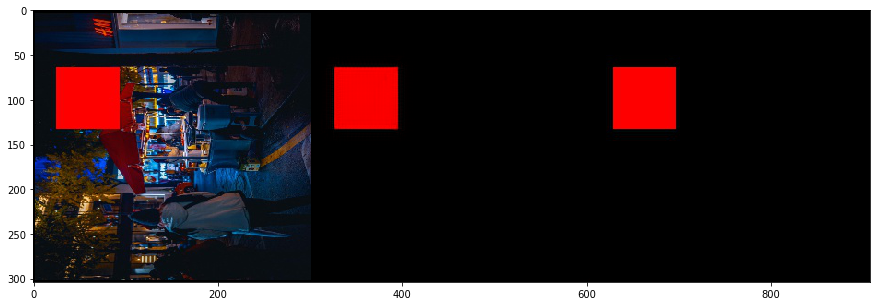

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


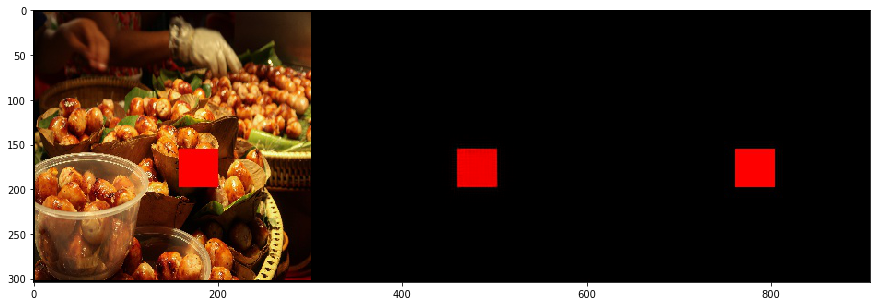

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


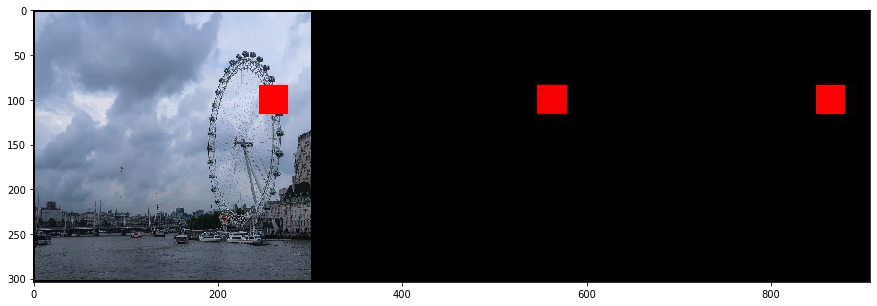

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


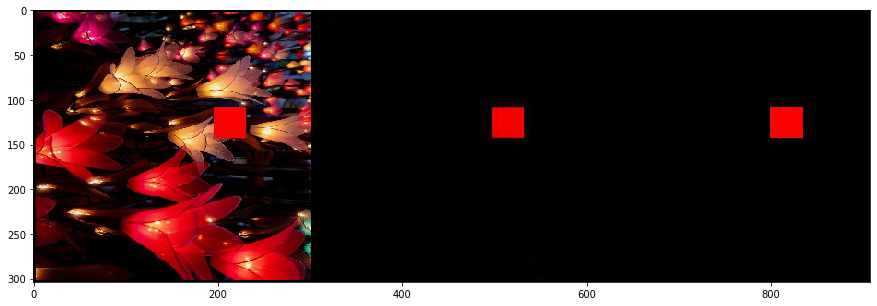

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


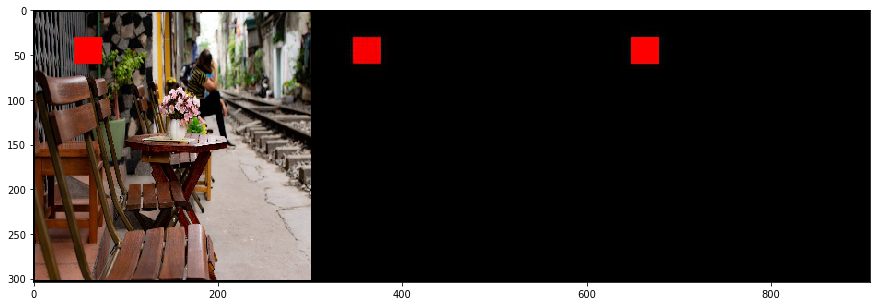

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


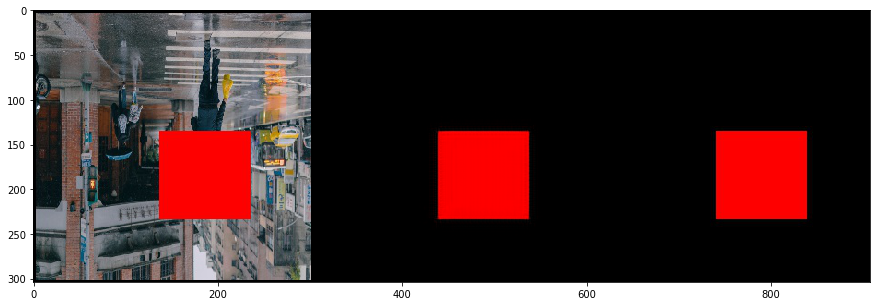

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


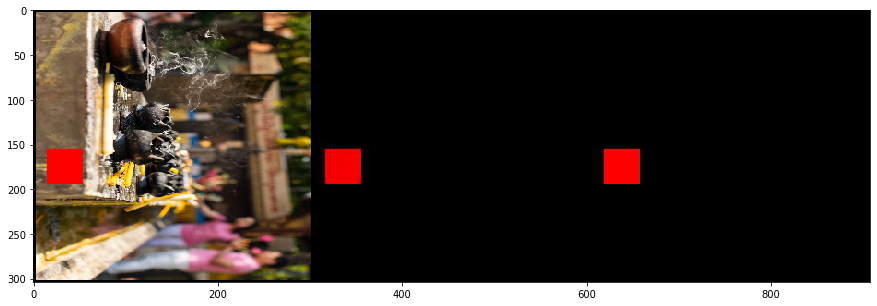

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


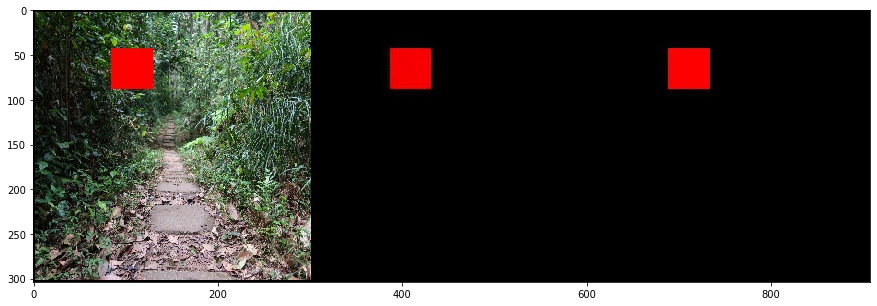

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


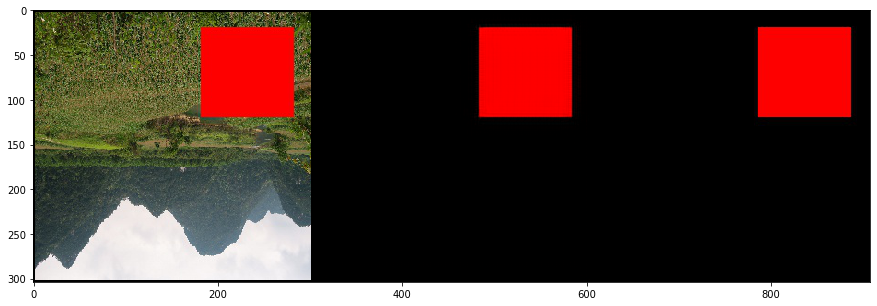

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


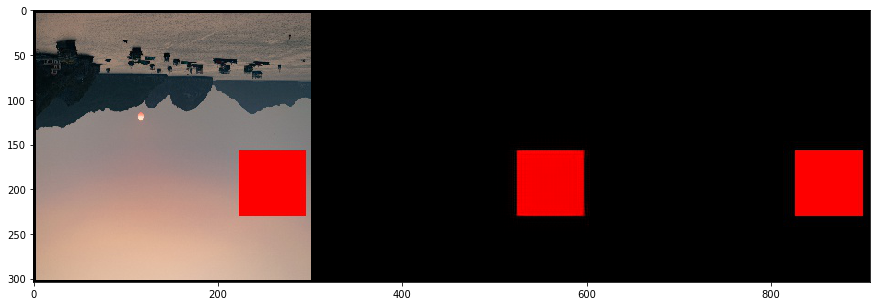

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


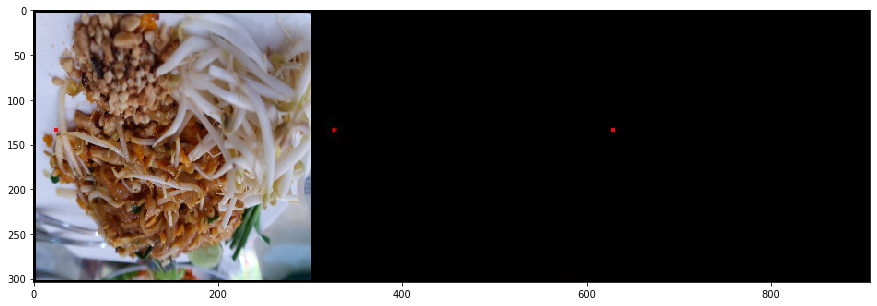

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


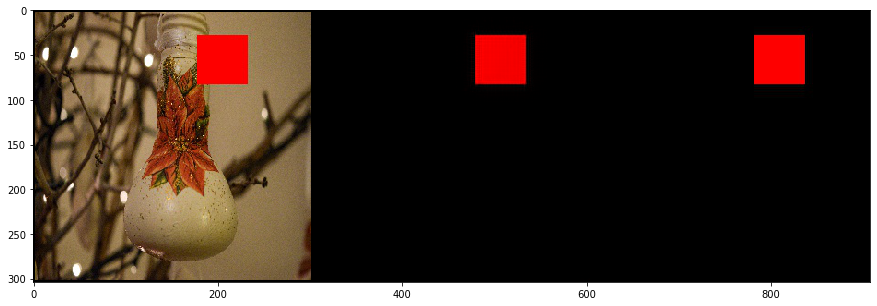

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


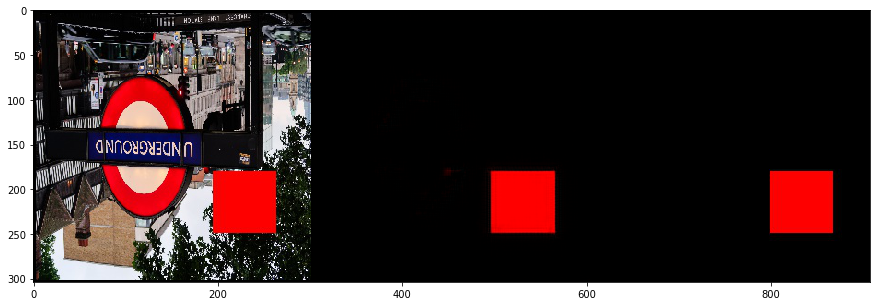

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


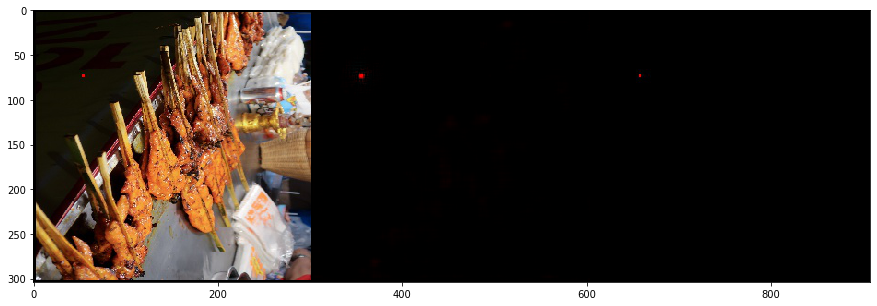

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


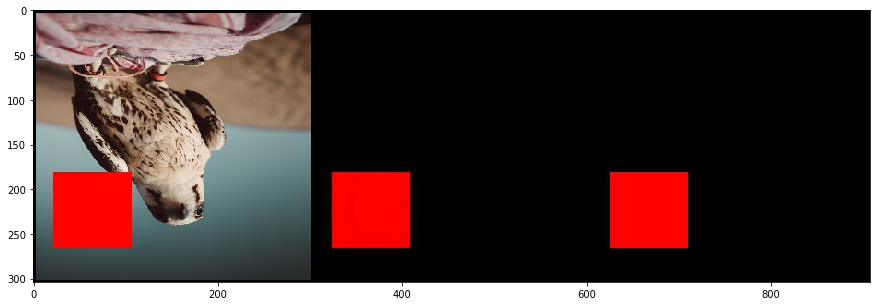

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


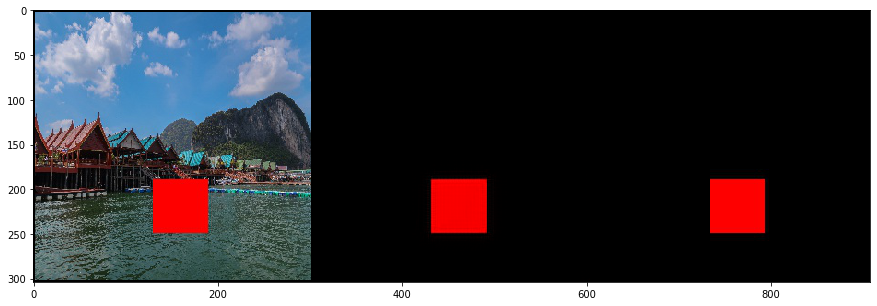

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


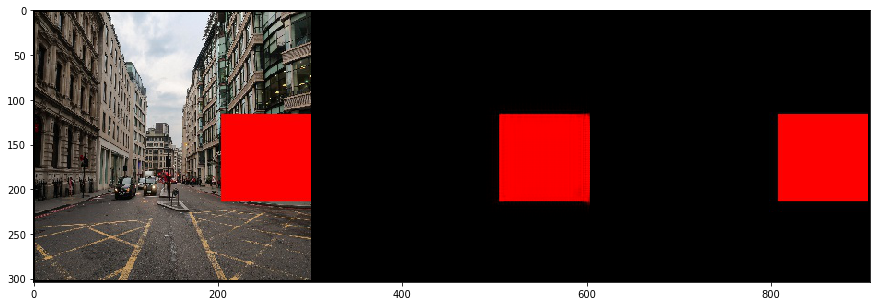

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


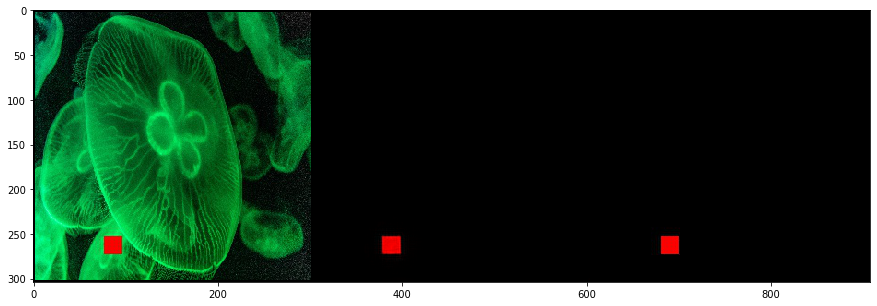

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


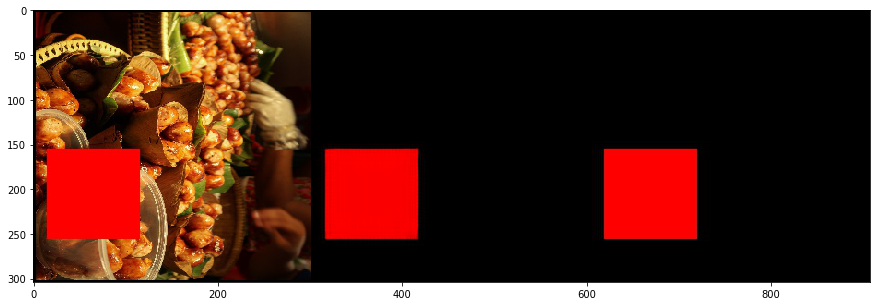

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


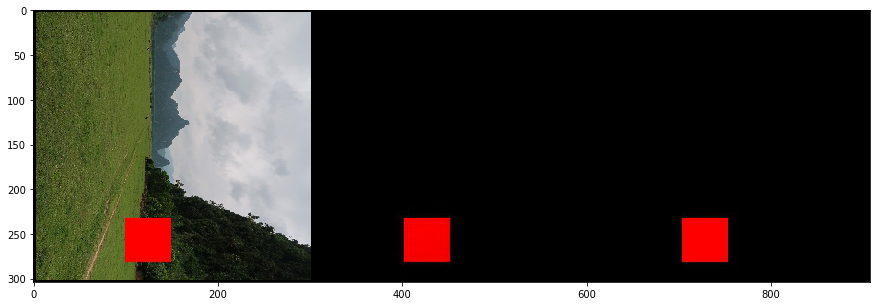

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


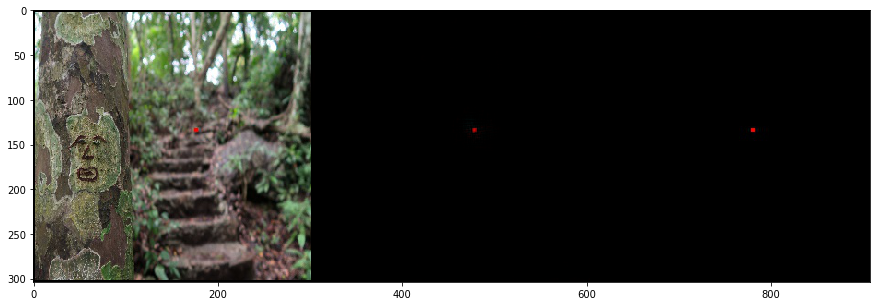

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


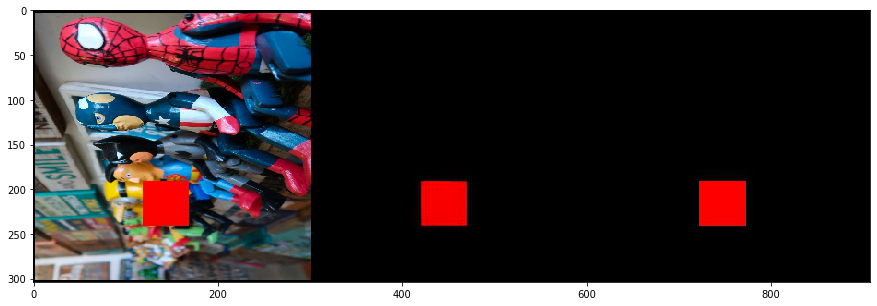

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


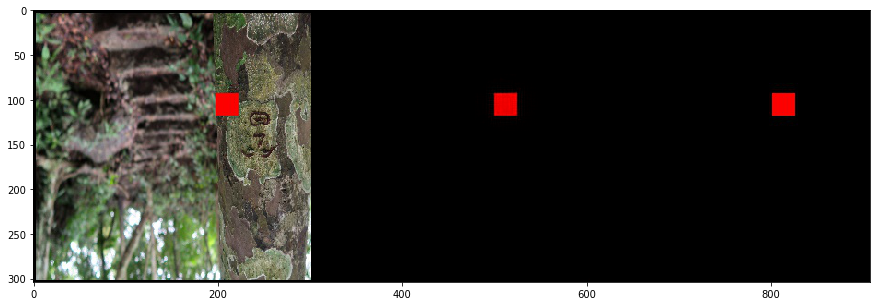

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


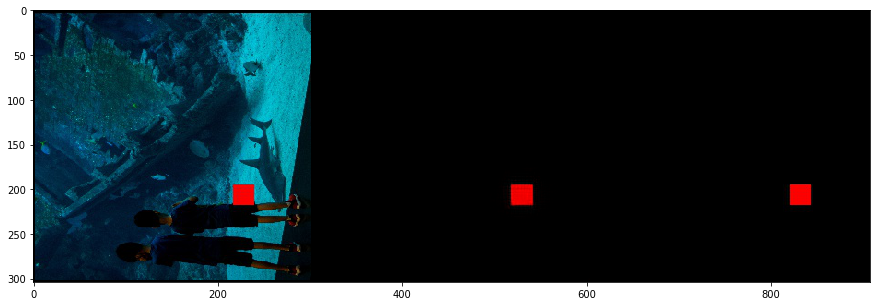

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


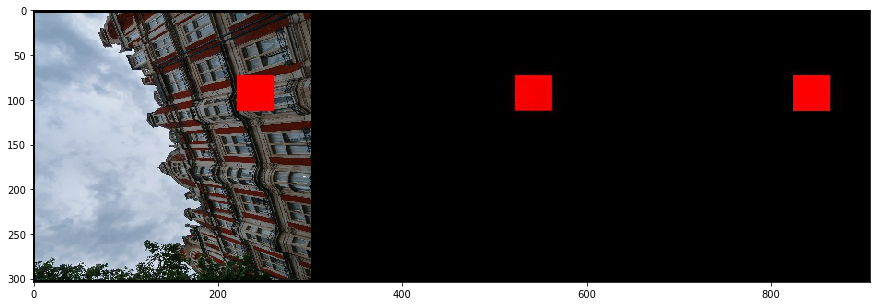

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


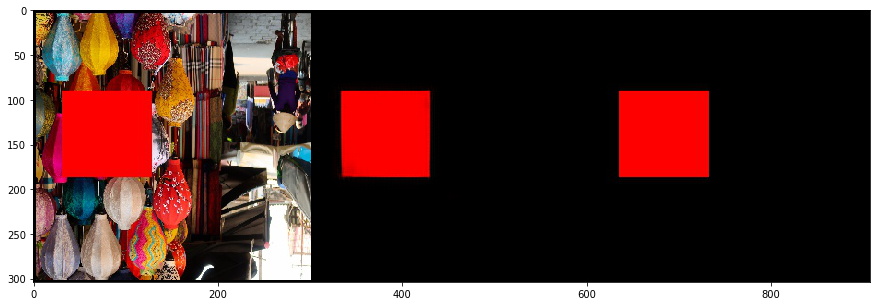

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


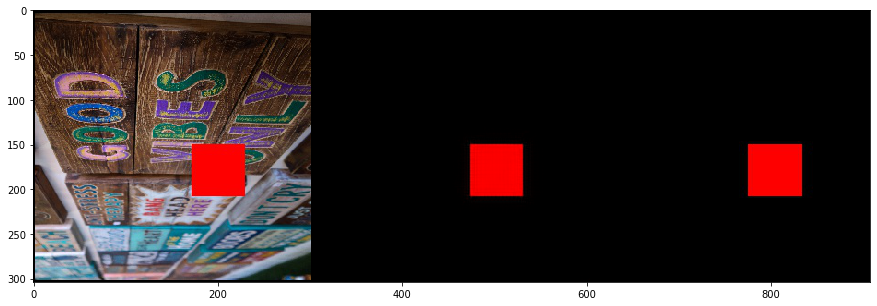

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


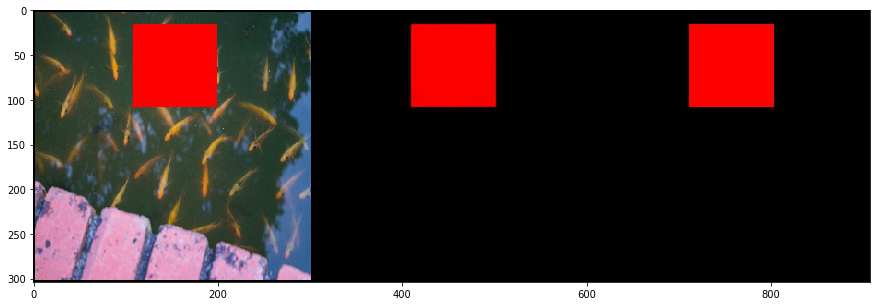

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


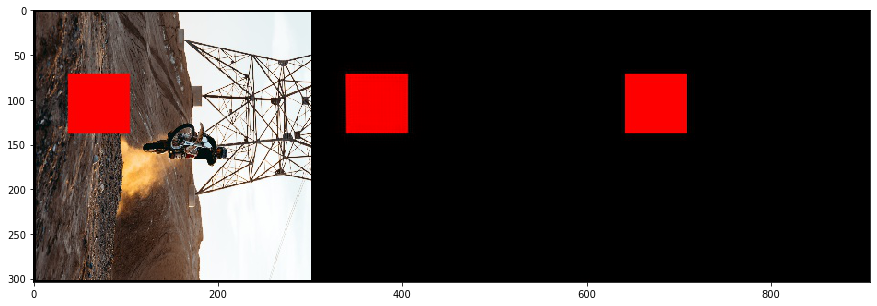

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


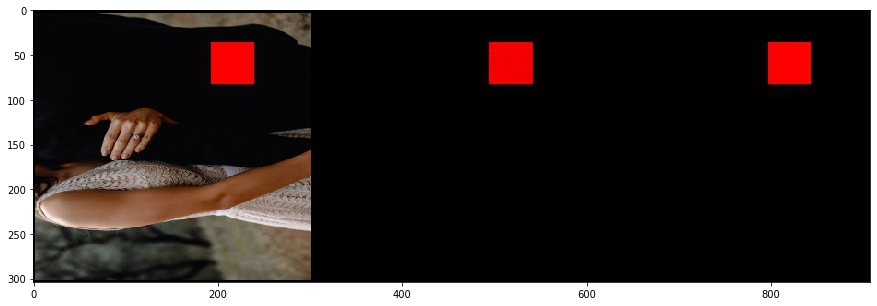

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


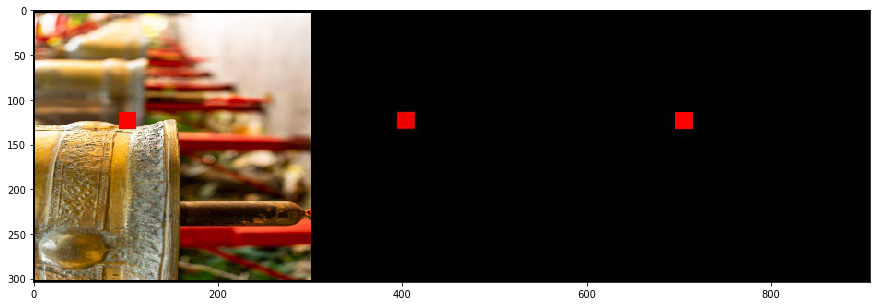

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


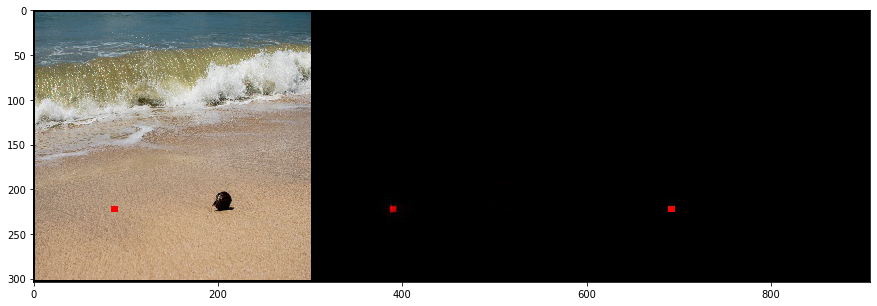

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


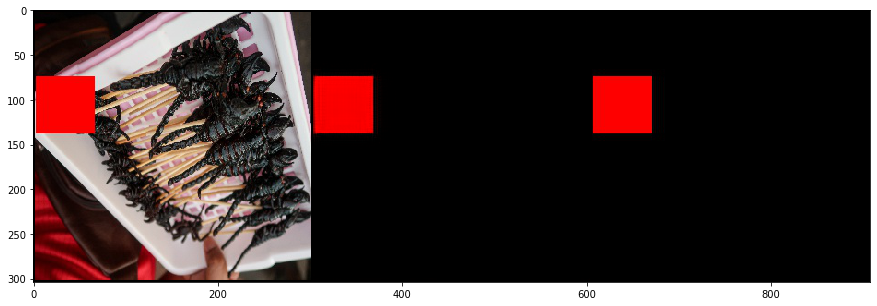

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


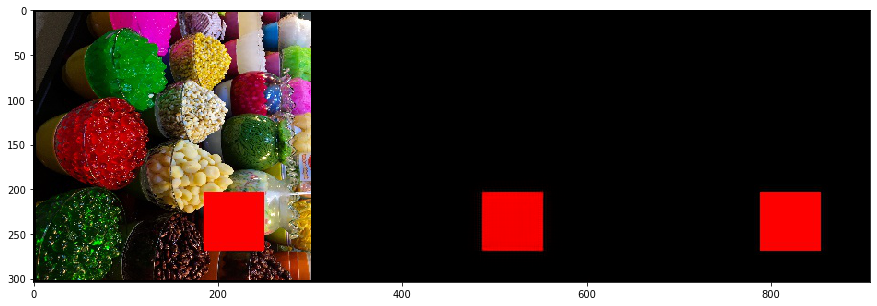

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


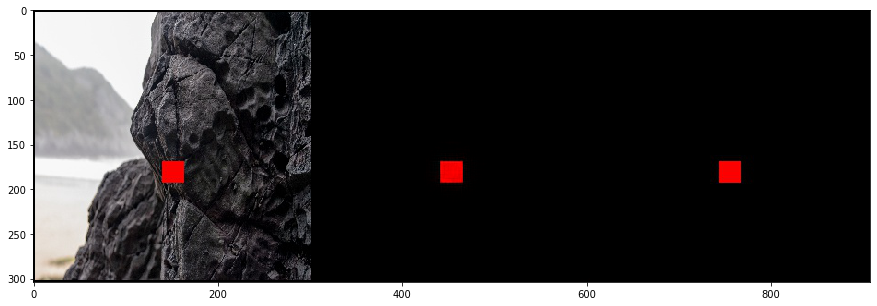

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


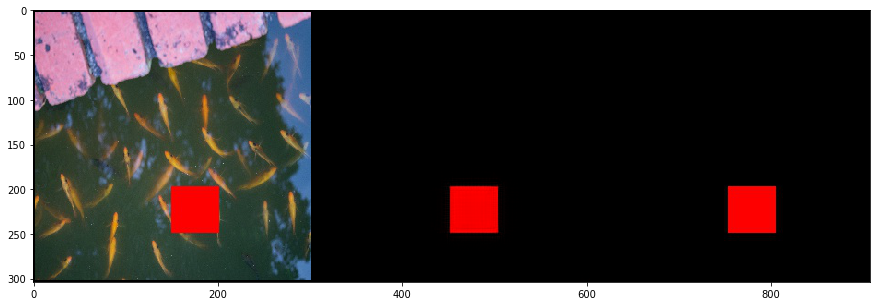

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


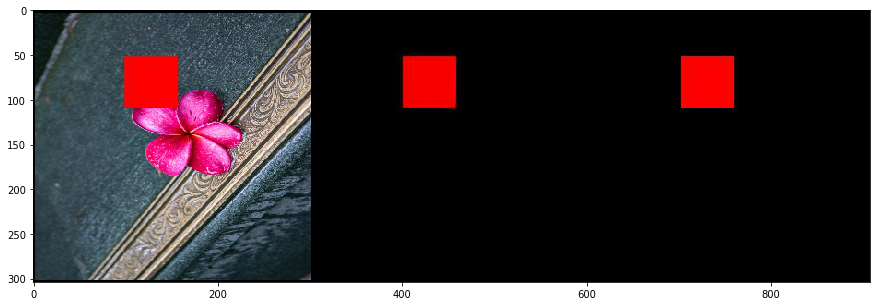

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


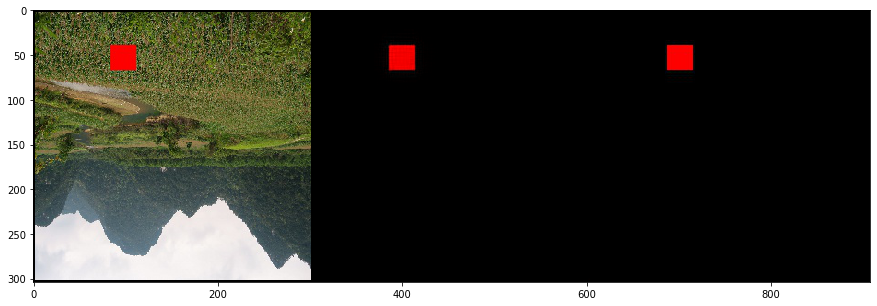

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


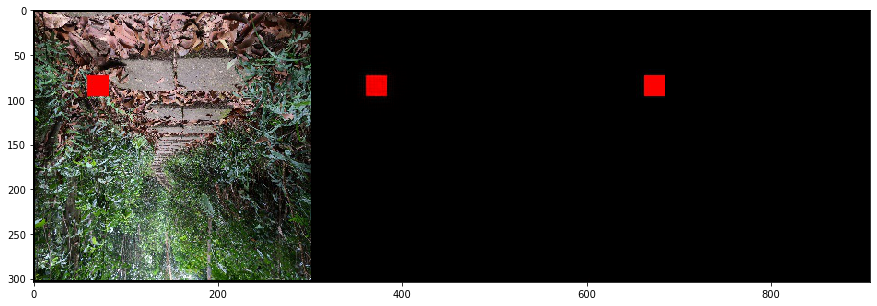

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


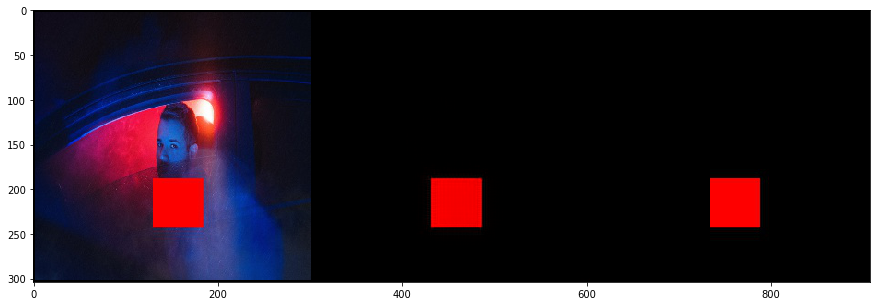

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


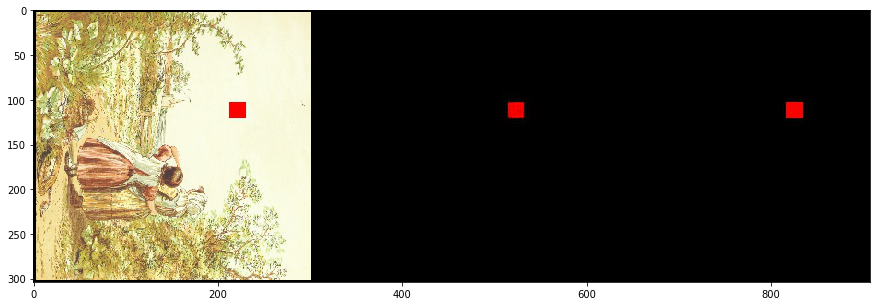

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


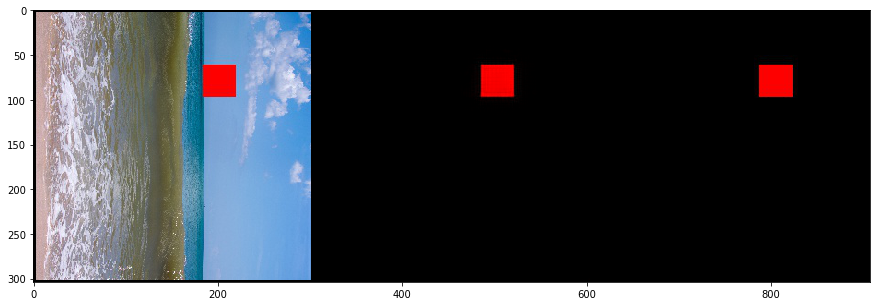

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


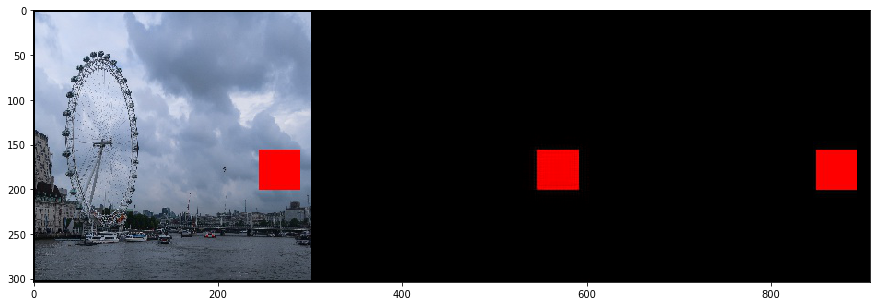

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


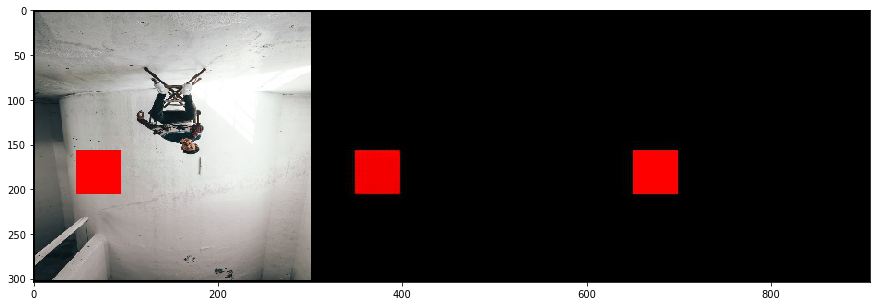

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


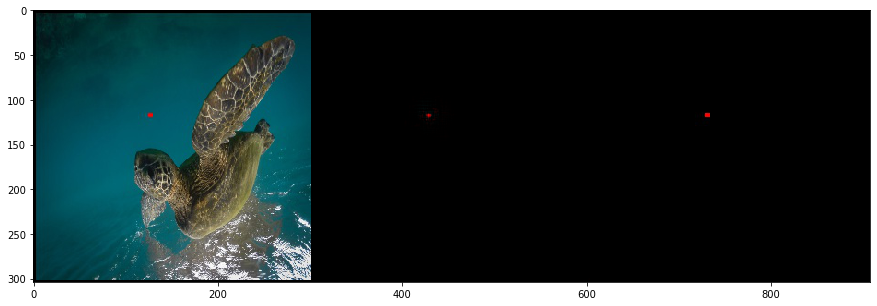

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


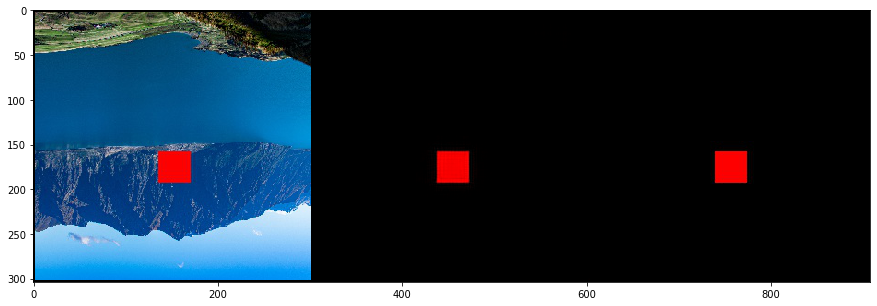

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


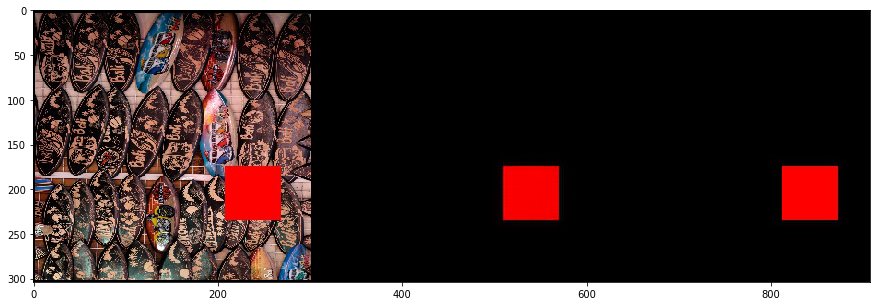

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


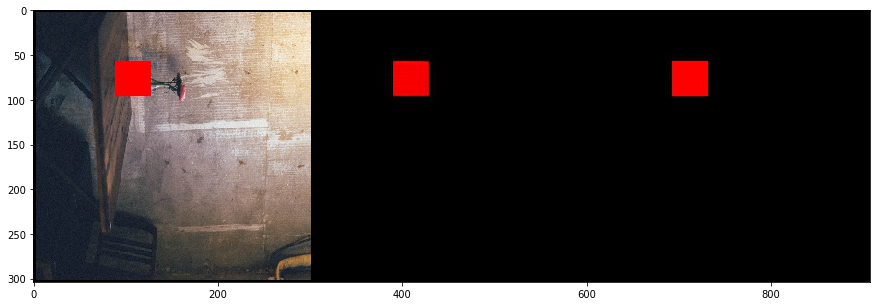

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


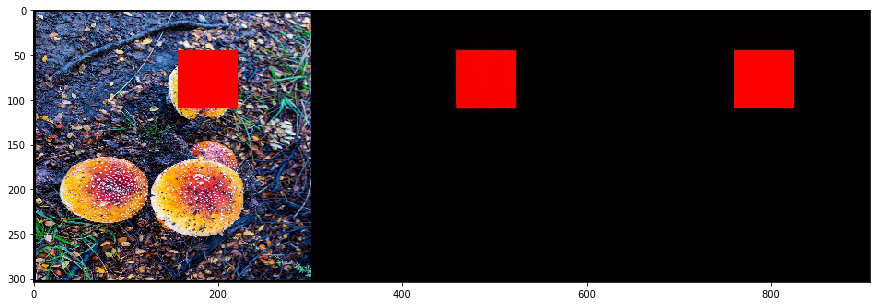

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


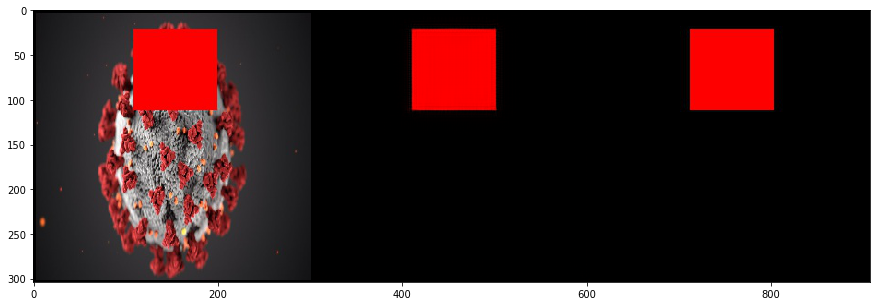

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


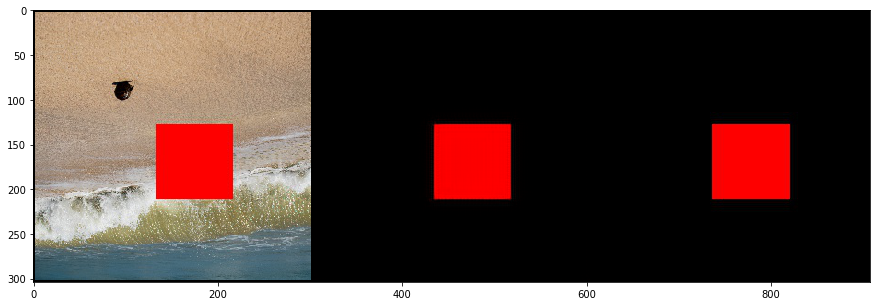

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


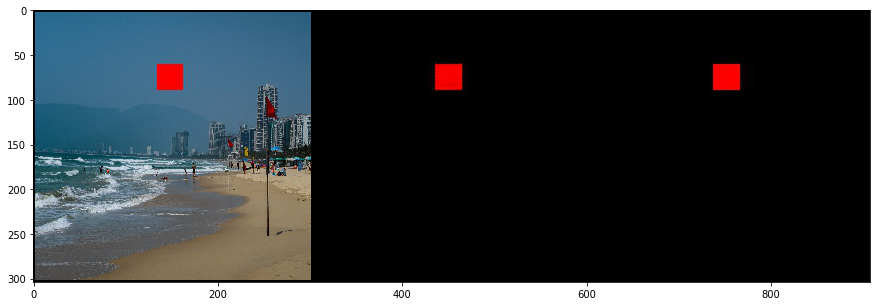

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


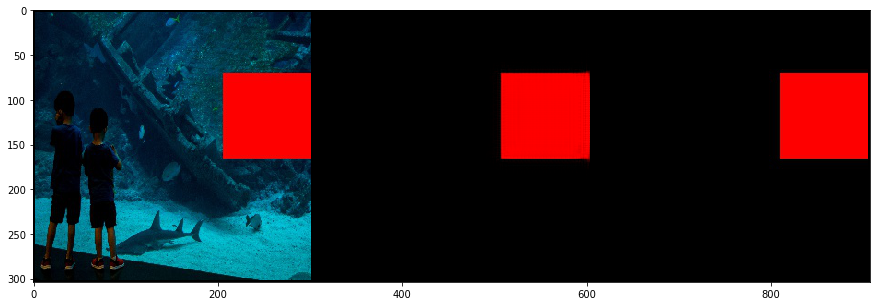

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


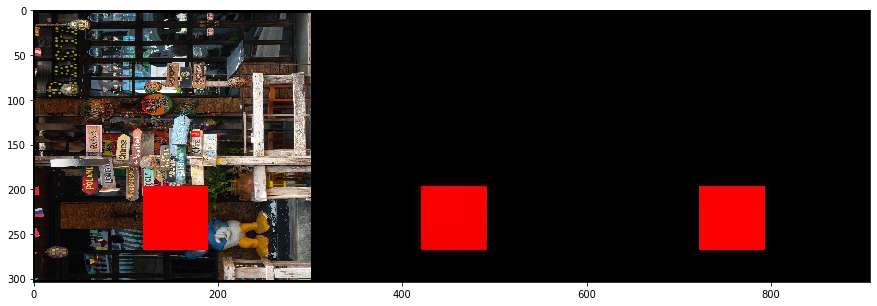

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


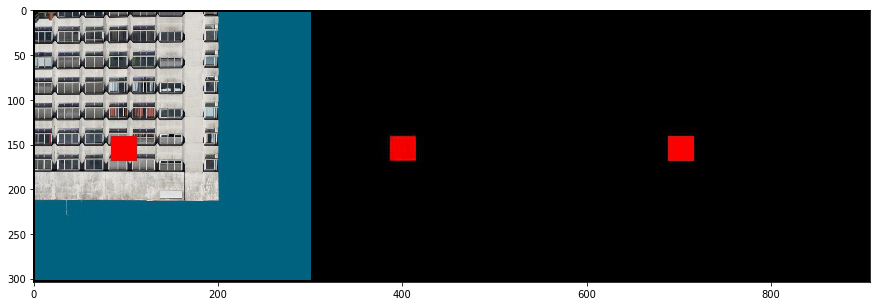

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


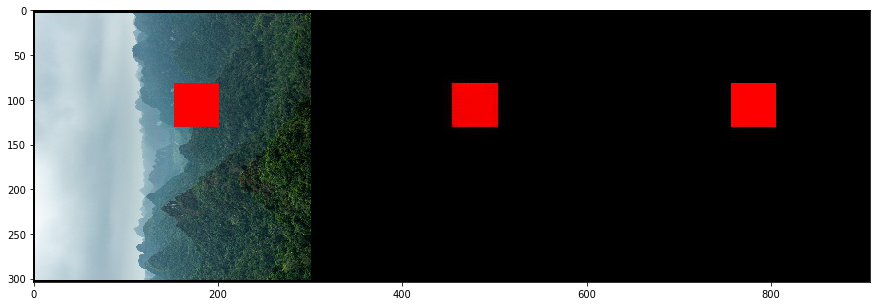

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


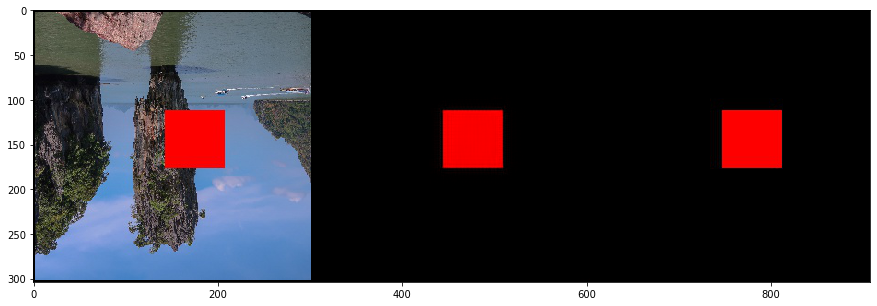

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


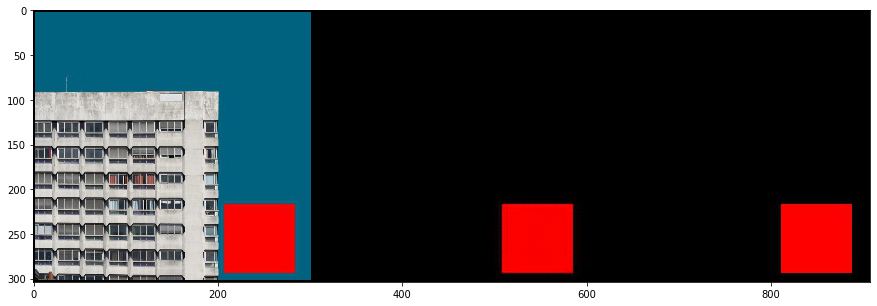

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


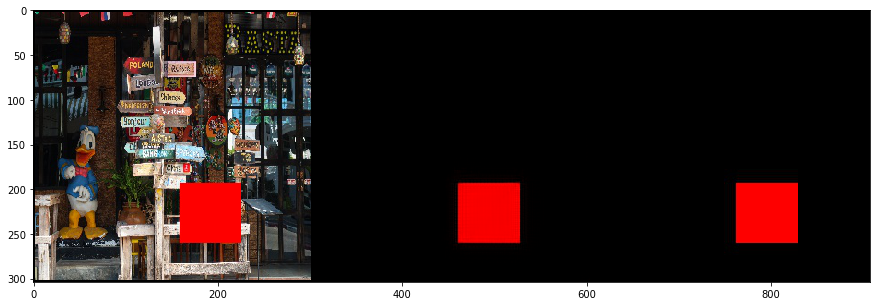

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


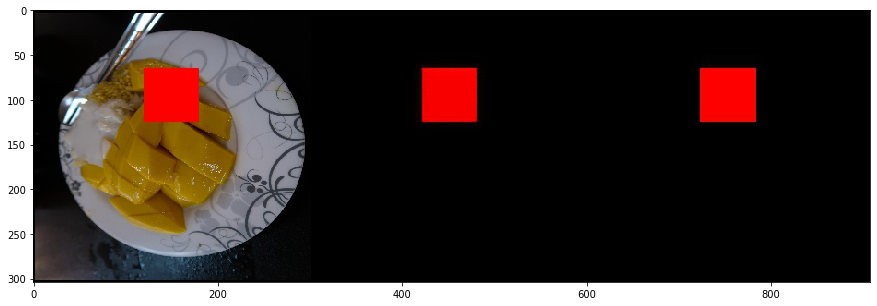

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


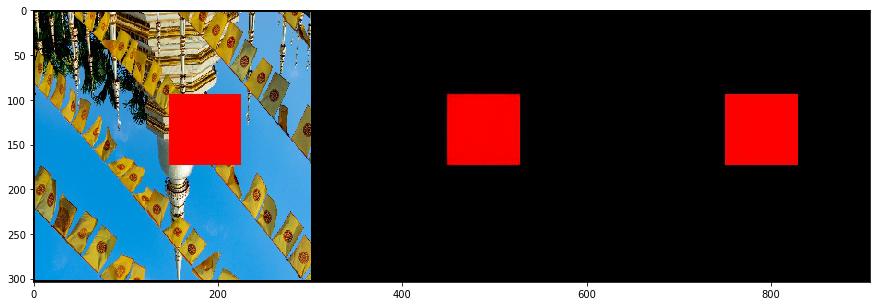

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


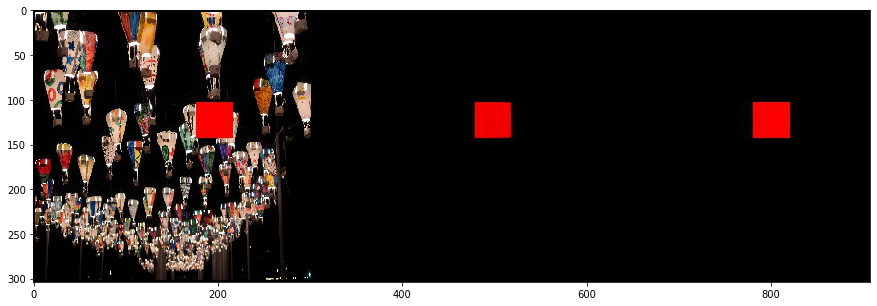

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


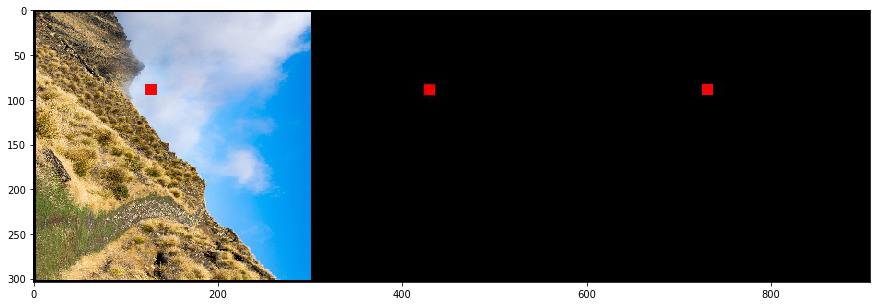

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


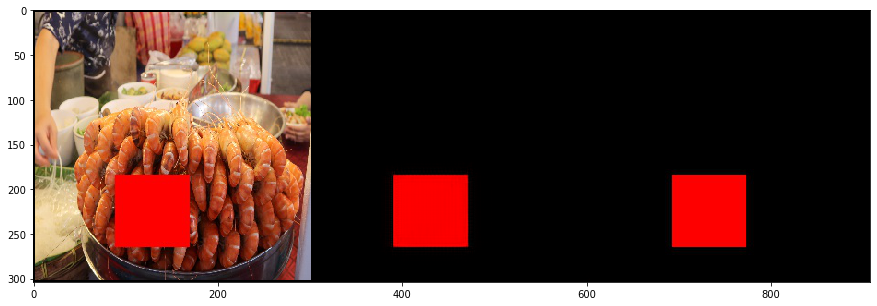

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


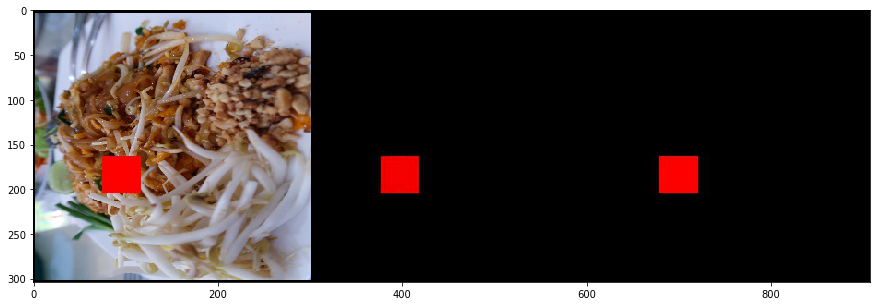

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


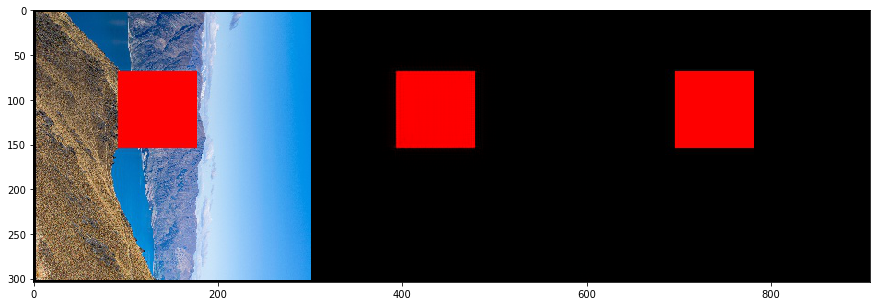

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


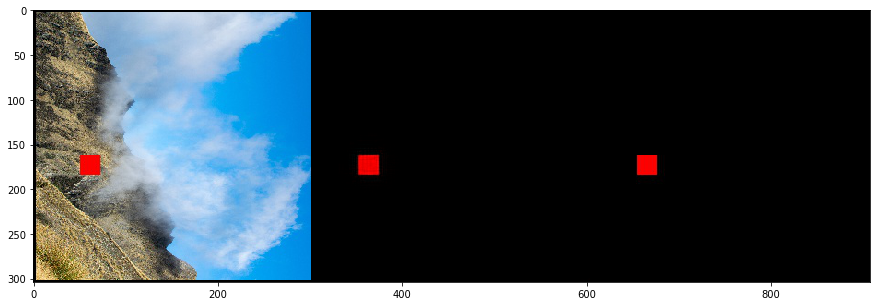

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


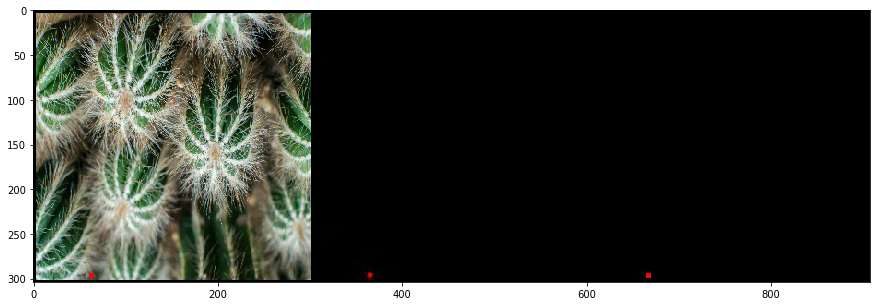

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


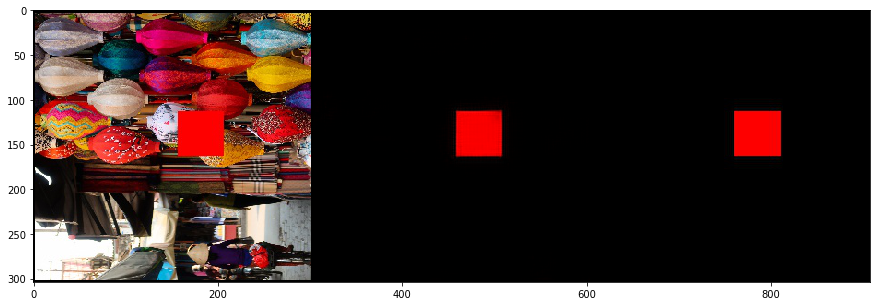

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


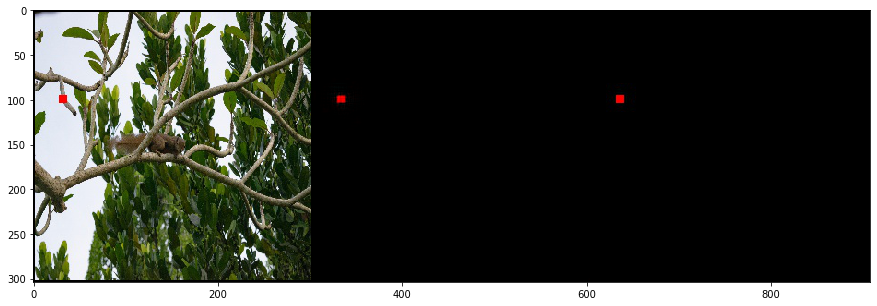

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


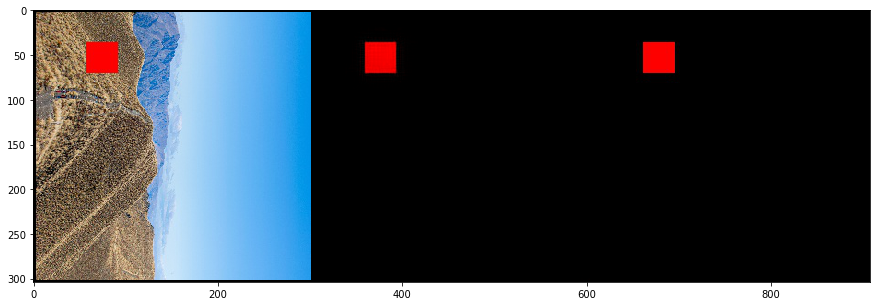

In [54]:
import torchvision
import matplotlib.cm as cm

def imshow(img):
    #img = img / 2 + 0.5     # unnormalize
    npimg = img.numpy()
    plt.figure(figsize = (15,5))
    
    npimage = np.transpose(npimg, (1, 2, 0))
    npimage = cv2.cvtColor(npimage, cv2.COLOR_BGR2RGB)
    
    plt.imshow(npimage, aspect='auto', vmin=0, vmax=255)
    plt.show()
    

# show images

#def chunks(lst, n):
#    """Yield successive n-sized chunks from lst."""
#    for i in range(0, len(lst), n):
#        yield lst[i:i + n]

for i in range(0, len(images)):
    temp = [images[i], outputs[i], expected[i]]
    imshow(torchvision.utils.make_grid(temp))

    
#print('\nINPUTS')
#imshow(torchvision.utils.make_grid(images[16:32]))
#print('\nOUTPUTS')
#imshow(torchvision.utils.make_grid(outputs[16:32]))
#print('\nLABELS')
#imshow(torchvision.utils.make_grid(expected[16:32]))